In [1]:
pip install googlemaps

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for googlemaps: filename=googlemaps-4.6.0-py3-none-any.whl size=38554 sha256=5ed3f23969104d21a487f7393fbf60bbb6cfce9ef5b023d723552fd55481d5cd
  Stored in directory: /root/.cache/pip/wheels/80/db/c0/6d958585fa97b20e250bf437acf7e6e715b4809c2dd4e55367
Successfully built googlemaps


In [2]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import sklearn
import pandas_profiling
import seaborn as sns
import random as rn
import os
import warnings
import scipy.stats as stats
import googlemaps
import folium
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from collections import Counter
from tqdm.notebook import tqdm

plt.rc('font', family='Malgun Gothic')
plt.rc('axes', unicode_minus=False)

%matplotlib inline
warnings.filterwarnings(action='ignore')

In [3]:
pwd

'/content'

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 1. 원본 데이터 불러오기

In [ ]:
train = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/train.csv')
test = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/test.csv')
bts = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/bus_bts.csv')

### (1) 데이터 확인

In [ ]:
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,5.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,2.0,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,26.0,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,8~9_ride,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,7.0,2.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,6.0,1.0,8.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,2.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,18.0,8.0,26.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,getoff_station_name,user_category,user_count
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,화북초등학교,1,1
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,고산동산(광양방면),1,1
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,정존마을,4,1
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,정존마을,1,1
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,제주국제공항(종점),4,1


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 415423 entries, 0 to 415422
Data columns (total 21 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             415423 non-null  int64  
 1   date           415423 non-null  object 
 2   bus_route_id   415423 non-null  int64  
 3   in_out         415423 non-null  object 
 4   station_code   415423 non-null  int64  
 5   station_name   415423 non-null  object 
 6   latitude       415423 non-null  float64
 7   longitude      415423 non-null  float64
 8   6~7_ride       415423 non-null  float64
 9   7~8_ride       415423 non-null  float64
 10  8~9_ride       415423 non-null  float64
 11  9~10_ride      415423 non-null  float64
 12  10~11_ride     415423 non-null  float64
 13  11~12_ride     415423 non-null  float64
 14  6~7_takeoff    415423 non-null  float64
 15  7~8_takeoff    415423 non-null  float64
 16  8~9_takeoff    415423 non-null  float64
 17  9~10_takeoff   415423 non-nul

In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 228170 entries, 0 to 228169
Data columns (total 20 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             228170 non-null  int64  
 1   date           228170 non-null  object 
 2   bus_route_id   228170 non-null  int64  
 3   in_out         228170 non-null  object 
 4   station_code   228170 non-null  int64  
 5   station_name   228170 non-null  object 
 6   latitude       228170 non-null  float64
 7   longitude      228170 non-null  float64
 8   6~7_ride       228170 non-null  float64
 9   7~8_ride       228170 non-null  float64
 10  8~9_ride       228170 non-null  float64
 11  9~10_ride      228170 non-null  float64
 12  10~11_ride     228170 non-null  float64
 13  11~12_ride     228170 non-null  float64
 14  6~7_takeoff    228170 non-null  float64
 15  7~8_takeoff    228170 non-null  float64
 16  8~9_takeoff    228170 non-null  float64
 17  9~10_takeoff   228170 non-nul

In [ ]:
bts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2409414 entries, 0 to 2409413
Data columns (total 13 columns):
 #   Column               Dtype  
---  ------               -----  
 0   user_card_id         float64
 1   bus_route_id         int64  
 2   vhc_id               int64  
 3   geton_date           object 
 4   geton_time           object 
 5   geton_station_code   int64  
 6   geton_station_name   object 
 7   getoff_date          object 
 8   getoff_time          object 
 9   getoff_station_code  float64
 10  getoff_station_name  object 
 11  user_category        int64  
 12  user_count           int64  
dtypes: float64(2), int64(5), object(6)
memory usage: 239.0+ MB


### (2) Pandas Profiling

In [ ]:
pr_bts = bts.profile_report()
pr_bts.to_file('pr_bts_report.html')
pr_bts

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
pr_train = train.profile_report()
pr_train.to_file('pr_train_report.html')
pr_train

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
pr_test = test.profile_report()
pr_test.to_file('pr_test_report.html')
pr_test

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 2. 데이터 설명

( train, test , bus_bts 공통 사항)

해당 데이터에는 버스카드를 통해 결제를 한 경우에 대한 정류소 승, 하차 데이터로 모든 승차정보의 경우는 기록이 되어있지만, 

버스에서 하차를 할 때, 버스카드를 찍지 않는 경우, 해당 기록이 비어 있는 상태입니다. 따라서, 승차 인원수와 하차 인원수가 동일하지 않고 다소 차이가 있음을 미리 알려드립니다.



(train, test csv 공통사항)

해당 버스정류장에 대한 각각의 위도, 경도가 제공이 되어있는 상태로 같은 정류장 이름이지만 위도와 경도가 서로 다른 경우가 존재합니다. 

해당 경우는, 같은 정류장 이름을 가지고 있는 길 건너편의 정류장에 해당이 됩니다.

 



 1. train.csv and test.csv

 

train.csv 의 경우, 2019년 9월 제주도의 각 날짜, 출근시간(6시~12시)의 버스 정류장별 승하차 인원, 퇴근시간(18시~20시)의 버스 정류장별 승차 인원이 기록되어 있습니다.

test.csv의 경우, 2019년 10월의 각 날짜, 출근시간(오전 6시~12시)의 버스 정류장별 승하차 인원이 기록되어 있습니다.



2. bus_bts.csv

 

bus_bts의 경우, 버스카드별로 승하차 정보가 기록이 되어있습니다. 해당 데이터는 탑승 시간대가오전 6시부터 12시 사이인 경우만 있습니다.



3.     submission_제출양식.csv 

 

submission_제출양식의 경우, test data의 ID와 목표변수인 18시~20시 승차 인원로만 이루어져 있습니다.

참가자분들께서는 test.csv에서 ID와 예측값을 결합하여, 해당 submission_제출양식.csv 파일형식 처럼 만든 이후,

해당 제출 파일 양식 그대로(변수명 포함된 상태) 제출을 해주시면 됩니다



추가 사용 가능 데이터

      a) (8회 kcb 시각화 대회의 제주도 금융라이프 데이터(jeju_financial_life_data.csv)

      b) 행정동별 위도 경도 데이터 https://dacon.io/?module=file&act=procFileDownload&file_srl=244977&sid=8cd192144ab18be0e02e4a16f851729b&module_srl=228539  (H - 행정동, B - 법정동)

### (1) train, test data

- id : 해당 데이터에서의 고유한 ID(train, test와의 중복은 없음)
- date : 날짜
- bus_route_id : 노선ID
- in_out : 시내버스, 시외버스 구분
- station_code : 해당 승하차 정류소의 ID
- station_name : 해당 승하차 정류소의 이름
- latitude : 해당 버스 정류장의 위도 (같은 정류장 이름이어도 버스의 진행 방향에 따라 다를 수 있음)
- longitude : 해당 버스 정류장의 경도 (같은 정류장 이름이어도 버스의 진행 방향에 따라 다를 수 있음)
- X~Y_ride : X:00:00부터 X:59:59까지 승차한 인원 수
- X~Y_takeoff : X:00:00부터 X:59:59까지 하차한 인원 수
- 18~20_ride : 18:00:00부터 19:59:59까지 승차한 인원 수 (train data에만 존재)

### (2) bus_bts data

- user_card_id : 해당 승객의 버스카드ID
- bus_route_id : 노선ID
- vhc_id : 차량ID
- geton_date : 해당 승객이 탑승한 날짜
- geton_time : 해당 승객이 탑승한 시간
- geton_station_code : 승차정류소의 ID
- geton_station_name : 승차정류소의 이름
- getoff_date : 해당 승객이 하차한 날짜 (하차태그 없는 경우, NaN)
- getoff_time : 해당 승객이 하차한 시간 (하차태그 없는 경우, NaN)
- getoff_station_code : 하차정류소의 ID (하차태그 없는 경우, NaN)
- getoff_station_name : 하차정류소의 이름 (하차태그 없는 경우, NaN)
- user_category : 승객 구분 (01-일반, 02-어린이, 04-청소년, 06-경로, 27-장애 일반, 28-장애 동반, 29-유공 일반, 30-유공 동반)
- user_count : 해당 버스카드로 계산한 인원수 ( ex- 3은 3명 분의 버스비를 해당 카드 하나로 계산한 것)

## 3. 데이터 전처리

#### * 함수 생성

In [ ]:
# 제주시/서귀포시 뽑아내는 함수
def get_si(address):
  if address.split()[1]=='아봉로':
    si='제주시'
  elif address.split()[1]=='제주특별자치도':
    si=address.split()[2]
  else:
    si=address.split()[1]
  return si

### (1) bts

In [ ]:
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,getoff_station_name,user_category,user_count
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,화북초등학교,1,1
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,고산동산(광양방면),1,1
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,정존마을,4,1
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,정존마을,1,1
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,제주국제공항(종점),4,1


#### 1) station_code
- bus_code 생성
- 경도, 위도 이용해서 주소 및 시구분 항목 추가 (제주시:1, 서귀포시:0)

In [ ]:
# 버스 방향에 따라 station_name이 같더라도 station_code가 다를 수 있음.
print('geton code count:', len(bts["geton_station_code"].unique())),
print('geton name count:', len(bts["geton_station_name"].unique())),
print('getoff code count:', len(bts["getoff_station_code"].unique())),
print('getoff name count:', len(bts["getoff_station_name"].unique()))

geton code count: 3456
geton name count: 1941
getoff code count: 3435
getoff name count: 1909


In [ ]:
# train,test 파일 내 기재된 경도, 위도를 중복없이 추출하기
train_code=train[['station_code', 'latitude', 'longitude']]
test_code=test[['station_code', 'latitude', 'longitude']]
bus_code=pd.concat([train_code, test_code]).drop_duplicates()
bus_code.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3601 entries, 0 to 198932
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   station_code  3601 non-null   int64  
 1   latitude      3601 non-null   float64
 2   longitude     3601 non-null   float64
dtypes: float64(2), int64(1)
memory usage: 112.5 KB


In [ ]:
import getpass
gmaps_key = getpass.getpass('api:')
gmaps = googlemaps.Client(key=gmaps_key)

In [ ]:
# 위도, 경도로 주소 항목 추가하기
for idx, j in tqdm(bus_code.iterrows()):
  bus_map = gmaps.reverse_geocode((j.latitude, j.longitude), language="ko")
  bus_add=bus_map[0].get("formatted_address")
  bus_code.loc[idx, "address"] = bus_add

0it [00:00, ?it/s]

In [ ]:
bus_code.head(10)

,station_code,latitude,longitude,address
0,344,33.48990,126.49373,대한민국 제주시 제주 썬호텔
1,357,33.48944,126.48508,대한민국 제주특별자치도 제주시 도령로
2,432,33.48181,126.47352,대한민국 제주시 정존마을
3,1579,33.50577,126.49252,대한민국 제주특별자치도 제주시 용담2동 1984-5
4,1646,33.25579,126.41260,대한민국 서귀포시 중문관광단지입구
5,1648,33.25862,126.40442,대한민국 제주특별자치도 서귀포시 예래동 2085-3
6,1660,33.24309,126.42472,대한민국 제주특별자치도 서귀포시 중문동 2504
7,1666,33.26598,126.37082,대한민국 제주특별자치도 서귀포시 안덕면 창천리 153-47
8,1726,33.23603,126.47827,대한민국 제주특별자치도 서귀포시 대천동 4400-1
9,2008,33.23977,126.56450,대한민국 서귀포시 서귀포항


In [ ]:
bus_code['si']=bus_code['address'].apply(lambda address: get_si(address))
bus_code['si'].value_counts()

제주시     2059
서귀포시    1542
Name: si, dtype: int64

In [ ]:
# 제주시:1, 서귀포시:0 코드로 변경
bus_code['si_class'] = bus_code['si'].apply(lambda si : 1 if si=='제주시' else 0)
bus_code['si_class'].value_counts()

1    2059
0    1542
Name: si_class, dtype: int64

In [ ]:
bus_code.head()

,station_code,latitude,longitude,address,si,si_class
0,344,33.48990,126.49373,대한민국 제주시 제주 썬호텔,제주시,1
1,357,33.48944,126.48508,대한민국 제주특별자치도 제주시 도령로,제주시,1
2,432,33.48181,126.47352,대한민국 제주시 정존마을,제주시,1
3,1579,33.50577,126.49252,대한민국 제주특별자치도 제주시 용담2동 1984-5,제주시,1
4,1646,33.25579,126.41260,대한민국 서귀포시 중문관광단지입구,서귀포시,0


In [ ]:
#geton_code에 맞추어 위도, 경도 붙이기
bts=pd.merge(bts, bus_code, how='left', left_on='geton_station_code', right_on='station_code')
bts.rename(columns={'address':'geton_address', 'si':'geton_si'}, inplace=True)
bts.drop(columns=['station_code', 'latitude', 'longitude', 'si_class'], axis=1,inplace=True)
bts=pd.merge(bts, bus_code, how='left', left_on='getoff_station_code', right_on='station_code')
bts.rename(columns={'address':'getoff_address', 'si':'getoff_si'}, inplace=True)
bts.drop(columns=['station_code', 'latitude', 'longitude', 'si_class'], axis=1,inplace=True)
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,getoff_station_name,user_category,user_count,geton_address,geton_si,getoff_address,getoff_si
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,화북초등학교,1,1,대한민국 제주특별자치도 제주시 노형동 968-3,제주시,대한민국 제주시 화북초등학교,제주시
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,고산동산(광양방면),1,1,대한민국 제주특별자치도 제주시 노형동 968-3,제주시,대한민국 제주시 고산동산(광양방면)/제주4.3트라우마센터,제주시
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,정존마을,4,1,대한민국 서귀포시 동광환승정류장4(제주방면),서귀포시,대한민국 제주시 정존마을,제주시
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,정존마을,1,1,대한민국 서귀포시 대정환승정류장(대정읍사무소),서귀포시,대한민국 제주시 정존마을,제주시
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,제주국제공항(종점),4,1,대한민국 서귀포시 삼정지에듀,서귀포시,대한민국 제주시 용담2동 제주국제공항,제주시


In [ ]:
bus_code['si_jeju'] = bus_code['si'].apply(lambda si : 1 if si=='제주시' else 0)
bus_code['si_seogwipo'] = bus_code['si'].apply(lambda si : 1 if si=='서귀포시' else 0)
bus_code.head()

,station_code,latitude,longitude,address,si,si_class,si_jeju,si_seogwipo
0,344,33.48990,126.49373,대한민국 제주시 제주 썬호텔,제주시,1,1,0
1,357,33.48944,126.48508,대한민국 제주특별자치도 제주시 도령로,제주시,1,1,0
2,432,33.48181,126.47352,대한민국 제주시 정존마을,제주시,1,1,0
3,1579,33.50577,126.49252,대한민국 제주특별자치도 제주시 용담2동 1984-5,제주시,1,1,0
4,1646,33.25579,126.41260,대한민국 서귀포시 중문관광단지입구,서귀포시,0,0,1


#### 2) date
- 공휴일 : 2, 주말(토/일) : 1 , 주중(월~금): 0

In [ ]:
bts['holiday'] = bts['geton_date'].apply(lambda geton_date: 1 if geton_date in ('2019-09-12','2019-09-13','2019-09-14','2019-10-03','2019-10-09') else 0)
bts['geton_date'] = pd.to_datetime(bts['geton_date'])
bts['geton_weekday'] = bts['geton_date'].dt.weekday
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,getoff_station_name,user_category,user_count,geton_address,geton_si,getoff_address,getoff_si,holiday,geton_weekday
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,화북초등학교,1,1,대한민국 제주특별자치도 제주시 노형동 968-3,제주시,대한민국 제주시 화북초등학교,제주시,0,1
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,고산동산(광양방면),1,1,대한민국 제주특별자치도 제주시 노형동 968-3,제주시,대한민국 제주시 고산동산(광양방면)/제주4.3트라우마센터,제주시,0,1
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,정존마을,4,1,대한민국 서귀포시 동광환승정류장4(제주방면),서귀포시,대한민국 제주시 정존마을,제주시,0,1
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,정존마을,1,1,대한민국 서귀포시 대정환승정류장(대정읍사무소),서귀포시,대한민국 제주시 정존마을,제주시,0,0
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,제주국제공항(종점),4,1,대한민국 서귀포시 삼정지에듀,서귀포시,대한민국 제주시 용담2동 제주국제공항,제주시,0,0


In [ ]:
bts['geton_weekday0'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==0 else 0)
bts['geton_weekday1'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==1 else 0)
bts['geton_weekday2'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==2 else 0)
bts['geton_weekday3'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==3 else 0)
bts['geton_weekday4'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==4 else 0)
bts['geton_weekday5'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==5 else 0)
bts['geton_weekday6'] = bts['geton_weekday'].apply(lambda geton_weekday : 1 if geton_weekday==6 else 0)
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,...,getoff_si,holiday,geton_weekday,geton_weekday0,geton_weekday1,geton_weekday2,geton_weekday3,geton_weekday4,geton_weekday5,geton_weekday6
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,...,제주시,0,1,0,1,0,0,0,0,0
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,...,제주시,0,1,0,1,0,0,0,0,0
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,...,제주시,0,1,0,1,0,0,0,0,0
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,...,제주시,0,0,1,0,0,0,0,0,0
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,...,제주시,0,0,1,0,0,0,0,0,0


#### 3) time
- 시간대별로 구분하는 항목 추가

In [ ]:
bts[bts['geton_time']<'06:00:00'], bts[bts['geton_time']>='12:00:00']

(Empty DataFrame
 Columns: [user_card_id, bus_route_id, vhc_id, geton_date, geton_time, geton_station_code, geton_station_name, getoff_date, getoff_time, getoff_station_code, getoff_station_name, user_category, user_count, geton_address, geton_si, getoff_address, getoff_si, holiday, geton_weekday, geton_weekday0, geton_weekday1, geton_weekday2, geton_weekday3, geton_weekday4, geton_weekday5, geton_weekday6]
 Index: []
 
 [0 rows x 26 columns], Empty DataFrame
 Columns: [user_card_id, bus_route_id, vhc_id, geton_date, geton_time, geton_station_code, geton_station_name, getoff_date, getoff_time, getoff_station_code, getoff_station_name, user_category, user_count, geton_address, geton_si, getoff_address, getoff_si, holiday, geton_weekday, geton_weekday0, geton_weekday1, geton_weekday2, geton_weekday3, geton_weekday4, geton_weekday5, geton_weekday6]
 Index: []
 
 [0 rows x 26 columns])

In [ ]:
def get_time(time):
    if time>='11:00:00':
      time_class='11~12'
    elif time>='10:00:00':
      time_class='10~11'
    elif time>='09:00:00':
      time_class='09~10'
    elif time>='08:00:00':
      time_class='08~09'
    elif time>='07:00:00':
      time_class='07~08'
    else:
      time_class='06~07'
    return time_class

In [ ]:
bts['geton_time_class'] = bts['geton_time'].apply(lambda time: get_time(time))
bts.head()

,user_card_id,bus_route_id,vhc_id,geton_date,geton_time,geton_station_code,geton_station_name,getoff_date,getoff_time,getoff_station_code,...,holiday,geton_weekday,geton_weekday0,geton_weekday1,geton_weekday2,geton_weekday3,geton_weekday4,geton_weekday5,geton_weekday6,geton_time_class
0,1.010010e+15,23000000,149793674,2019-09-10,06:34:45,360,노형오거리,2019-09-10,07:10:31,592.0,...,0,1,0,1,0,0,0,0,0,06~07
1,1.010010e+15,23000000,149793674,2019-09-10,06:34:58,360,노형오거리,2019-09-10,06:56:27,3273.0,...,0,1,0,1,0,0,0,0,0,06~07
2,1.019160e+15,21420000,149793535,2019-09-10,07:19:07,2495,동광환승정류장4(제주방면),2019-09-10,07:40:29,431.0,...,0,1,0,1,0,0,0,0,0,07~08
3,1.019150e+15,21420000,149793512,2019-09-09,09:14:47,3282,대정환승정류장(대정읍사무소),2019-09-09,10:02:46,431.0,...,0,0,1,0,0,0,0,0,0,09~10
4,1.010010e+15,21420000,149793512,2019-09-09,09:28:53,2820,삼정지에듀,2019-09-09,10:21:37,2972.0,...,0,0,1,0,0,0,0,0,0,09~10


#### 4) 데이터 저장

In [ ]:
bus_code.to_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bus_code_amend.csv",sep=",", encoding='utf-8')
bts.to_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bts_amend.csv", sep=",", encoding='utf-8')

### (2) train, test

In [ ]:
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,5.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,2.0,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,26.0,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,8~9_ride,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,7.0,2.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,6.0,1.0,8.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,2.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,18.0,8.0,26.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


#### 1) typhoon
- 태풍 영향 미친 날: 1, 아닌 날:0

In [ ]:
train['typhoon'] = train['date'].apply(lambda date : 1 if date in ('2019-09-06', '2019-09-07', '2019-09-20', '2019-09-21', '2019-09-22', '2019-10-01','2019-10-02') else 0)
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,typhoon
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0


In [ ]:
test['typhoon'] = test['date'].apply(lambda date : 1 if date in ('2019-09-06', '2019-09-07', '2019-09-20', '2019-09-21', '2019-09-22', '2019-10-01','2019-10-02') else 0)
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,typhoon
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,2.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,1.0,8.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,1
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,8.0,26.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,1
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1


In [ ]:
train['typhoon'].value_counts(), test['typhoon'].value_counts()

(0    356459
 1     58964
 Name: typhoon, dtype: int64, 0    199538
 1     28632
 Name: typhoon, dtype: int64)

#### 2) rain
- 비가 온 날 :1, 오지 않은 날:0

In [ ]:
train['rain'] = train['date'].apply(lambda date : 1 if date in ('2019-09-04', '2019-09-05', '2019-09-06', '2019-09-07', '2019-09-10', '2019-09-11', '2019-09-12', '2019-09-13', '2019-09-14', '2019-09-22', '2019-10-02', '2019-10-03', '2019-10-05', '2019-10-07') else 0)
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,typhoon,rain
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0,0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,0,0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0


In [ ]:
test['rain'] = test['date'].apply(lambda date : 1 if date in ('2019-09-04', '2019-09-05', '2019-09-06', '2019-09-07', '2019-09-10', '2019-09-11', '2019-09-12', '2019-09-13', '2019-09-14', '2019-09-22', '2019-10-02', '2019-10-03', '2019-10-05', '2019-10-07') else 0)
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,typhoon,rain
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,9.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1,0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,8.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,26.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1,0


In [ ]:
train['rain'].value_counts(), test['rain'].value_counts()

(0    291236
 1    124187
 Name: rain, dtype: int64, 0    174033
 1     54137
 Name: rain, dtype: int64)

In [ ]:
# 데이터 확인
train[train['date']=='2019-09-06']

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,typhoon,rain
72428,72428,2019-09-06,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,3.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
72429,72429,2019-09-06,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,5.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1,1
72430,72430,2019-09-06,4270000,시외,432,정존마을,33.48181,126.47352,1.0,7.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1,1
72431,72431,2019-09-06,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,16.0,0.0,0.0,0.0,0.0,0.0,0.0,21.0,1,1
72432,72432,2019-09-06,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87775,87775,2019-09-06,32820000,시내,1080,애월고등학교,33.46262,126.33447,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
87776,87776,2019-09-06,32820000,시내,1129,한림환승정류장(한림리),33.41437,126.26336,2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
87777,87777,2019-09-06,32820000,시내,1564,제주시외버스터미널,33.49946,126.51479,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
87778,87778,2019-09-06,32820000,시내,2468,화순환승정류장(안덕농협),33.24652,126.33507,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1


#### 3) date
- 공휴일 항목 생성
- weekday 생성 및 weekday별로 나누어 항목 추가 생성 (월-일: 0~6)

In [ ]:
train['holiday'] = train['date'].apply(lambda date: 1 if date in ('2019-09-12','2019-09-13','2019-09-14','2019-10-03','2019-10-09') else 0)
train['date'] = pd.to_datetime(train['date'])
train['weekday'] = train['date'].dt.weekday
train['weekday0'] = train['weekday'].apply(lambda weekday : 1 if weekday==0 else 0)
train['weekday1'] = train['weekday'].apply(lambda weekday : 1 if weekday==1 else 0)
train['weekday2'] = train['weekday'].apply(lambda weekday : 1 if weekday==2 else 0)
train['weekday3'] = train['weekday'].apply(lambda weekday : 1 if weekday==3 else 0)
train['weekday4'] = train['weekday'].apply(lambda weekday : 1 if weekday==4 else 0)
train['weekday5'] = train['weekday'].apply(lambda weekday : 1 if weekday==5 else 0)
train['weekday6'] = train['weekday'].apply(lambda weekday : 1 if weekday==6 else 0)
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,rain,holiday,weekday,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,6,0,0,0,0,0,0,1
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,6,0,0,0,0,0,0,1
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,6,0,0,0,0,0,0,1
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0,0,6,0,0,0,0,0,0,1
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0,0,6,0,0,0,0,0,0,1


In [ ]:
test['holiday'] = test['date'].apply(lambda date: 1 if date in ('2019-09-12','2019-09-13','2019-09-14','2019-10-03','2019-10-09') else 0)
test['date'] = pd.to_datetime(test['date'])
test['weekday'] = test['date'].dt.weekday
test['weekday0'] = test['weekday'].apply(lambda weekday : 1 if weekday==0 else 0)
test['weekday1'] = test['weekday'].apply(lambda weekday : 1 if weekday==1 else 0)
test['weekday2'] = test['weekday'].apply(lambda weekday : 1 if weekday==2 else 0)
test['weekday3'] = test['weekday'].apply(lambda weekday : 1 if weekday==3 else 0)
test['weekday4'] = test['weekday'].apply(lambda weekday : 1 if weekday==4 else 0)
test['weekday5'] = test['weekday'].apply(lambda weekday : 1 if weekday==5 else 0)
test['weekday6'] = test['weekday'].apply(lambda weekday : 1 if weekday==6 else 0)
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,rain,holiday,weekday,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,1,0,1,0,0,0,0,0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,1,0,1,0,0,0,0,0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,1,0,1,0,0,0,0,0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,0,0,1,0,1,0,0,0,0,0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0,0,1,0,1,0,0,0,0,0


#### 4) in_out
- inout_class: 시내:1, 시외:0 인 항목 추가
- in: 시내인경우 1, 아닌 경우 0
- out: 시외인 경우 1, 아닌 경우 0

In [ ]:
train['in_out'].value_counts()

시내    408500
시외      6923
Name: in_out, dtype: int64

In [ ]:
train['inout_class'] = train['in_out'].apply(lambda in_out : 1 if in_out=='시내' else 0)
train['in']=train['in_out'].apply(lambda in_out: 1 if in_out=='시내' else 0)
train['out']=train['in_out'].apply(lambda in_out: 1 if in_out=='시외' else 0)
train['inout_class'].value_counts()

1    408500
0      6923
Name: inout_class, dtype: int64

In [ ]:
train[train['in_out']=='시외']

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6,inout_class,in,out
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,0,0,0,0,1,0,0,1
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,0,0,0,0,1,0,0,1
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,0,0,0,0,1,0,0,1
6,6,2019-09-01,4270000,시외,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,0.0,1.0,...,0,0,0,0,0,0,1,0,0,1
7,7,2019-09-01,4270000,시외,1666,창천리,33.26598,126.37082,1.0,0.0,...,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
415128,415128,2019-09-30,32610000,시외,1726,강정농협,33.23603,126.47827,0.0,0.0,...,1,0,0,0,0,0,0,0,0,1
415184,415184,2019-09-30,32630000,시외,1726,강정농협,33.23603,126.47827,0.0,0.0,...,1,0,0,0,0,0,0,0,0,1
415199,415199,2019-09-30,32630000,시외,2699,약천사,33.24289,126.45084,0.0,0.0,...,1,0,0,0,0,0,0,0,0,1
415201,415201,2019-09-30,32630000,시외,2885,월평마을,33.24273,126.46096,0.0,1.0,...,1,0,0,0,0,0,0,0,0,1


In [ ]:
test['inout_class'] = test['in_out'].apply(lambda in_out : 1 if in_out=='시내' else 0)
test['in']=test['in_out'].apply(lambda in_out: 1 if in_out=='시내' else 0)
test['out']=test['in_out'].apply(lambda in_out: 1 if in_out=='시외' else 0)
test.head()


,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6,inout_class,in,out
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,1,0,0,0,0,0,0,0,1
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,1,0,0,0,0,0,0,0,1
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,1,0,0,0,0,0,0,0,1
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,0,1,0,0,0,0,0,1,1,0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0,1,0,0,0,0,0,1,1,0


#### 5) si_class
- bus_code와 merge
- si_class : 제주시인 경우 1, 서귀포시인 경우 0 
- si_jeju : 제주시인 경우 1, 아닌 경우 0
- si_seogwipo : 서귀포시인 경우 1, 아닌 경우 0

In [ ]:
bus_code.head()

,station_code,latitude,longitude,address,si,si_class,si_jeju,si_seogwipo
0,344,33.48990,126.49373,대한민국 제주시 제주 썬호텔,제주시,1,1,0
1,357,33.48944,126.48508,대한민국 제주특별자치도 제주시 도령로,제주시,1,1,0
2,432,33.48181,126.47352,대한민국 제주시 정존마을,제주시,1,1,0
3,1579,33.50577,126.49252,대한민국 제주특별자치도 제주시 용담2동 1984-5,제주시,1,1,0
4,1646,33.25579,126.41260,대한민국 서귀포시 중문관광단지입구,서귀포시,0,0,1


In [ ]:
bus_code2=bus_code[['station_code', 'si_class', 'si_jeju', 'si_seogwipo']]
train=pd.merge(train, bus_code2, how='left', on='station_code')
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday3,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,0,1,0,0,1,1,1,0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,0,1,0,0,1,1,1,0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,0,1,0,0,1,1,1,0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0,0,0,1,1,1,0,1,1,0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0,0,0,1,1,1,0,0,0,1


In [ ]:
test=pd.merge(test, bus_code2, how='left', on='station_code')
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday3,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,0,0,0,0,1,1,1,0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,0,0,0,0,1,1,1,0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,0,0,0,0,1,1,1,0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,0,0,0,0,1,1,0,1,1,0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0,0,0,0,1,1,0,0,0,1


#### 6) lat_lng
- 위도, 경도 합쳐진 항목 추가하기

In [ ]:
train['lat_lng']=train['latitude'].astype(str)+ ',' + train['longitude'].astype(str)
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,1,0,0,1,1,1,0,"33.4899,126.49373"
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,1,0,0,1,1,1,0,"33.48944,126.48508"
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,1,0,0,1,1,1,0,"33.48181,126.47352"
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0,0,1,1,1,0,1,1,0,"33.50577,126.49252"
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0,0,1,1,1,0,0,0,1,"33.255790000000005,126.4126"


In [ ]:
test['lat_lng']=test['latitude'].astype(str)+ ',' + test['longitude'].astype(str)
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,0,0,0,1,1,1,0,"33.4899,126.49373"
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,0,0,0,1,1,1,0,"33.48944,126.48508"
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,0,0,0,1,1,1,0,"33.48181,126.47352"
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,0,0,0,1,1,0,1,1,0,"33.50577,126.49252"
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0,0,0,1,1,0,0,0,1,"33.24872,126.41032"


#### 7) bus_route_id+station_code
- 두 항목 합치기

In [ ]:
train['route_code']=train['bus_route_id'].astype(str)+ ',' + train['station_code'].astype(str)
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,1,0,0,1,1,1,0,"33.4899,126.49373","4270000,344"
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,1,0,0,1,1,1,0,"33.48944,126.48508","4270000,357"
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,1,0,0,1,1,1,0,"33.48181,126.47352","4270000,432"
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0,1,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579"
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0,1,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646"


In [ ]:
test['route_code']=test['bus_route_id'].astype(str)+ ',' + test['station_code'].astype(str)
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,0,0,1,1,1,0,"33.4899,126.49373","4270000,344"
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,0,0,1,1,1,0,"33.48944,126.48508","4270000,357"
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,0,0,1,1,1,0,"33.48181,126.47352","4270000,432"
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,0,0,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579"
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,0,0,1,1,0,0,0,1,"33.24872,126.41032","4270000,1636"


#### 8) ride/takeoff 인원 더하기

In [ ]:
train['ride_count']=train['6~7_ride']+train['7~8_ride']+train['8~9_ride']+train['9~10_ride']+train['10~11_ride']+train['11~12_ride']
train['takeoff_count']=train['6~7_takeoff']+train['7~8_takeoff']+train['8~9_takeoff']+train['9~10_takeoff']+train['10~11_takeoff']+train['11~12_takeoff']
train.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",16.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",22.0,0.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",4.0,0.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",79.0,0.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646",0.0,1.0


In [ ]:
test['ride_count']=test['6~7_ride']+test['7~8_ride']+test['8~9_ride']+test['9~10_ride']+test['10~11_ride']+test['11~12_ride']
test['takeoff_count']=test['6~7_takeoff']+test['7~8_takeoff']+test['8~9_takeoff']+test['9~10_takeoff']+test['10~11_takeoff']+test['11~12_takeoff']
test.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",27.0,1.0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",33.0,0.0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",13.0,0.0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",84.0,0.0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,1,1,0,0,0,1,"33.24872,126.41032","4270000,1636",0.0,1.0


#### 9) 데이터 저장하기

In [ ]:
train.to_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/train_amend.csv", sep=",", encoding='utf-8')
test.to_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/test_amend.csv", sep=",", encoding='utf-8')

## 4. EDA
1. 출근 시간에 대한 총 승객 수 및 시간대별로 승객 수 확인
2. 요일(주중, 주말, 공휴일)별로 승객 수 확인
3. 시내/시외 별로 승객 수 확인
4. 비 유무에 따른 승객 수 확인
5. station_code 별로 승객수 확인
6. bus_route_id 별로 승객 수 확인
7. staion_code+bus_route_id별로 승객 수 확인
8. 위도, 경도 별로 승객 수 확인

### (1) 데이터 가져오기

In [ ]:
# 원본 데이터
train = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/train.csv')
test = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/test.csv')
bts = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/bus_bts.csv')

In [ ]:
# 수정한 데이터
bts_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bts_amend.csv", index_col = 0)
bus_code=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bus_code_amend.csv", index_col = 0)
test_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/test_amend.csv", index_col = 0)
train_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/train_amend.csv", index_col = 0)
train_re.head(10)

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",16.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",22.0,0.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",4.0,0.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",79.0,0.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646",0.0,1.0
5,5,2019-09-01,4270000,시내,1648,예래입구,33.25862,126.40442,0.0,0.0,...,1,1,0,0,0,1,"33.25862,126.40442","4270000,1648",1.0,2.0
6,6,2019-09-01,4270000,시외,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,0.0,1.0,...,0,0,1,0,0,1,"33.24309,126.42472","4270000,1660",3.0,6.0
7,7,2019-09-01,4270000,시외,1666,창천리,33.26598,126.37082,1.0,0.0,...,0,0,1,0,0,1,"33.26598,126.37082","4270000,1666",1.0,1.0
8,8,2019-09-01,4270000,시외,1726,강정농협,33.23603,126.47827,0.0,0.0,...,0,0,1,0,0,1,"33.23603,126.47827","4270000,1726",1.0,1.0
9,9,2019-09-01,4270000,시내,2008,서귀포항,33.23977,126.56450,0.0,0.0,...,1,1,0,0,0,1,"33.23977,126.5645","4270000,2008",0.0,4.0


In [ ]:
test_re.head(10)

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,415423,2019-10-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,4.0,4.0,...,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",27.0,1.0
1,415424,2019-10-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,6.0,...,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",33.0,0.0
2,415425,2019-10-01,4270000,시외,432,정존마을,33.48181,126.47352,2.0,4.0,...,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",13.0,0.0
3,415426,2019-10-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,1.0,11.0,...,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",84.0,0.0
4,415427,2019-10-01,4270000,시내,1636,롯데호텔,33.24872,126.41032,0.0,0.0,...,1,1,0,0,0,1,"33.24872,126.41032","4270000,1636",0.0,1.0
5,415428,2019-10-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646",0.0,2.0
6,415429,2019-10-01,4270000,시내,1648,예래입구,33.25862,126.40442,0.0,0.0,...,1,1,0,0,0,1,"33.25862,126.40442","4270000,1648",1.0,0.0
7,415430,2019-10-01,4270000,시외,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,0.0,0.0,...,0,0,1,0,0,1,"33.24309,126.42472","4270000,1660",7.0,4.0
8,415431,2019-10-01,4270000,시외,1662,씨에스호텔,33.24362,126.42032,0.0,0.0,...,0,0,1,0,0,1,"33.24362,126.42032","4270000,1662",1.0,2.0
9,415432,2019-10-01,4270000,시외,1666,창천리,33.26598,126.37082,0.0,1.0,...,0,0,1,0,0,1,"33.26598,126.37082","4270000,1666",3.0,1.0


In [ ]:
train_re.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 415423 entries, 0 to 415422
Data columns (total 42 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             415423 non-null  int64  
 1   date           415423 non-null  object 
 2   bus_route_id   415423 non-null  int64  
 3   in_out         415423 non-null  object 
 4   station_code   415423 non-null  int64  
 5   station_name   415423 non-null  object 
 6   latitude       415423 non-null  float64
 7   longitude      415423 non-null  float64
 8   6~7_ride       415423 non-null  float64
 9   7~8_ride       415423 non-null  float64
 10  8~9_ride       415423 non-null  float64
 11  9~10_ride      415423 non-null  float64
 12  10~11_ride     415423 non-null  float64
 13  11~12_ride     415423 non-null  float64
 14  6~7_takeoff    415423 non-null  float64
 15  7~8_takeoff    415423 non-null  float64
 16  8~9_takeoff    415423 non-null  float64
 17  9~10_takeoff   415423 non-nul

In [ ]:
test_re.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 228170 entries, 0 to 228169
Data columns (total 41 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             228170 non-null  int64  
 1   date           228170 non-null  object 
 2   bus_route_id   228170 non-null  int64  
 3   in_out         228170 non-null  object 
 4   station_code   228170 non-null  int64  
 5   station_name   228170 non-null  object 
 6   latitude       228170 non-null  float64
 7   longitude      228170 non-null  float64
 8   6~7_ride       228170 non-null  float64
 9   7~8_ride       228170 non-null  float64
 10  8~9_ride       228170 non-null  float64
 11  9~10_ride      228170 non-null  float64
 12  10~11_ride     228170 non-null  float64
 13  11~12_ride     228170 non-null  float64
 14  6~7_takeoff    228170 non-null  float64
 15  7~8_takeoff    228170 non-null  float64
 16  8~9_takeoff    228170 non-null  float64
 17  9~10_takeoff   228170 non-nul

### (2) 그래프로 확인

#### 1) heatmap

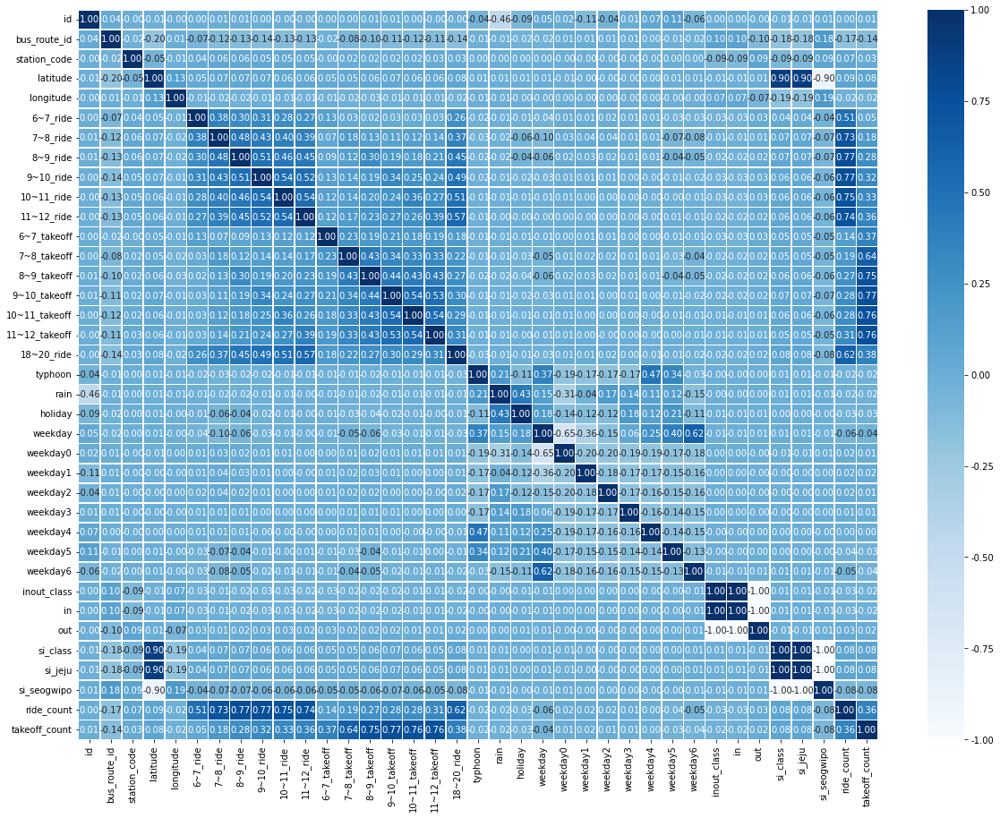

In [ ]:
# train_re
plt.figure(figsize=(20,15))
sns.heatmap(data = train_re.corr(), annot=True, fmt = '.2f', linewidths =.5, cmap='Blues');

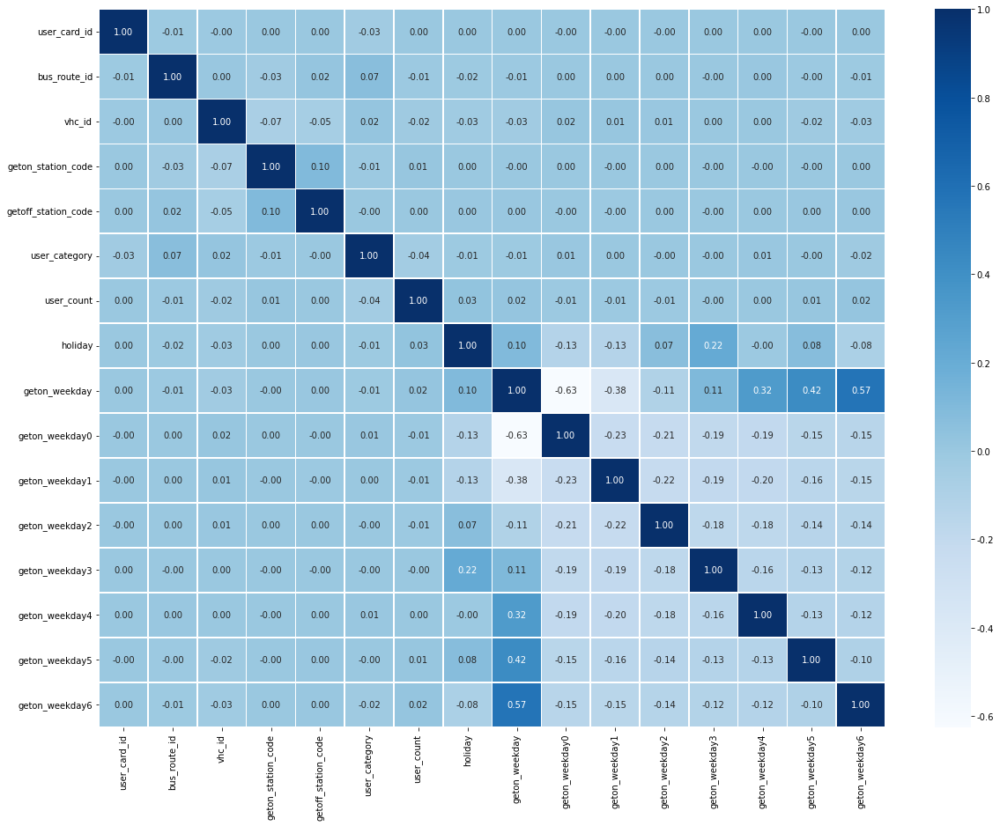

In [ ]:
# bts_re
plt.figure(figsize=(20,15))
sns.heatmap(data = bts_re.corr(), annot=True, fmt = '.2f', linewidths =.5, cmap='Blues');

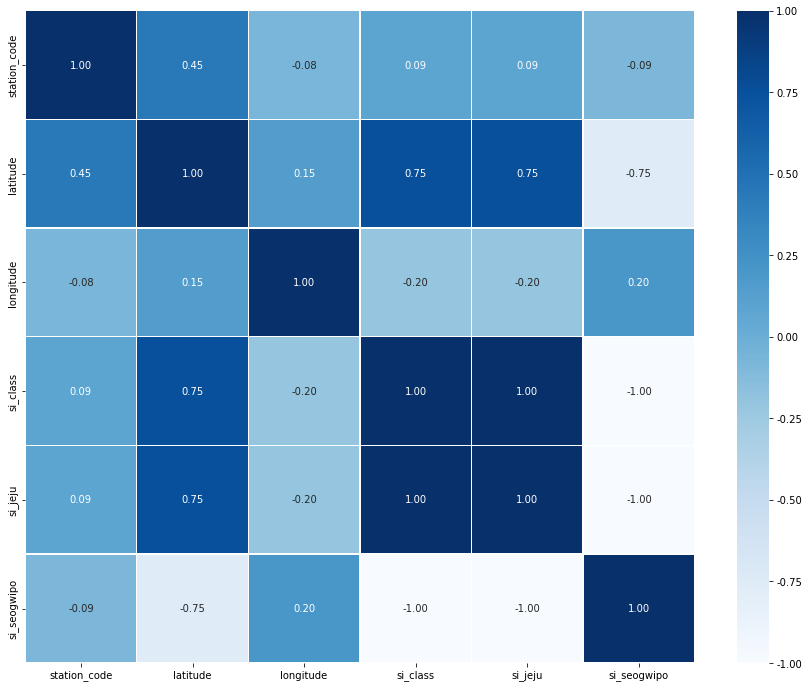

In [ ]:
#bus_code
plt.figure(figsize=(15, 12))
sns.heatmap(data = bus_code.corr(), annot=True, fmt = '.2f', linewidths =.5, cmap='Blues');

#### 2) lineplot

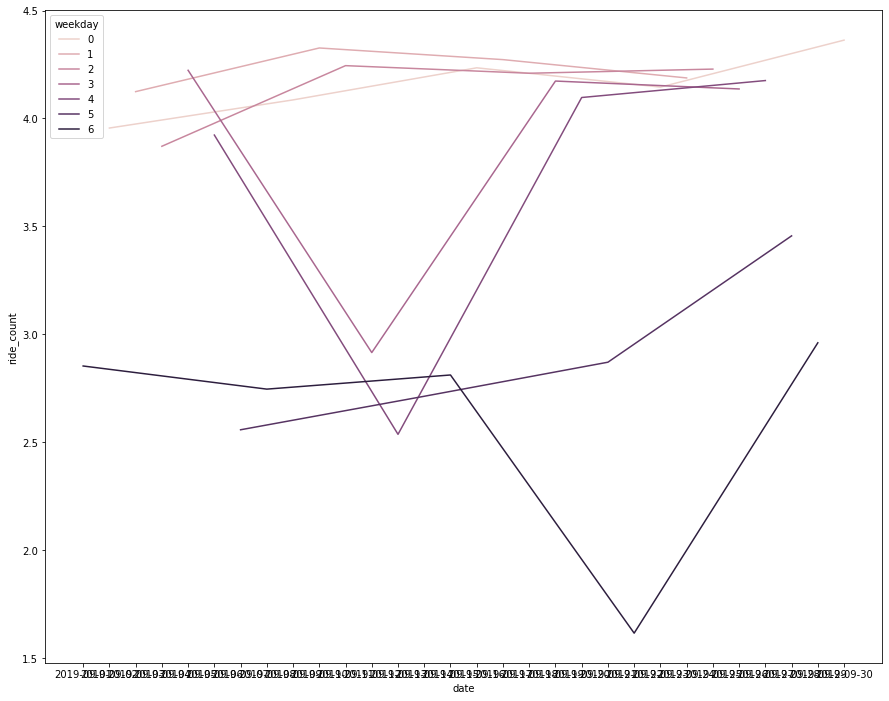

In [ ]:
plt.figure(figsize=(15, 12))
sns.lineplot(data=train_re, x="date", y="ride_count", ci=None, hue="weekday")
plt.show()

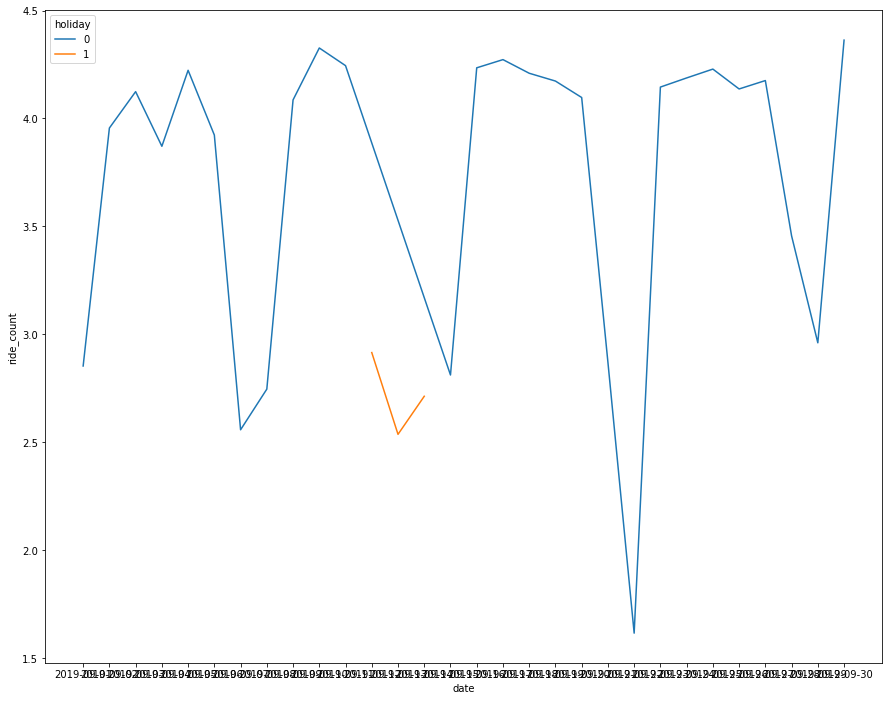

In [ ]:
plt.figure(figsize=(15, 12))
sns.lineplot(data=train_re, x="date", y="ride_count", ci=None, hue="holiday")
plt.show()

#### 3) boxplot

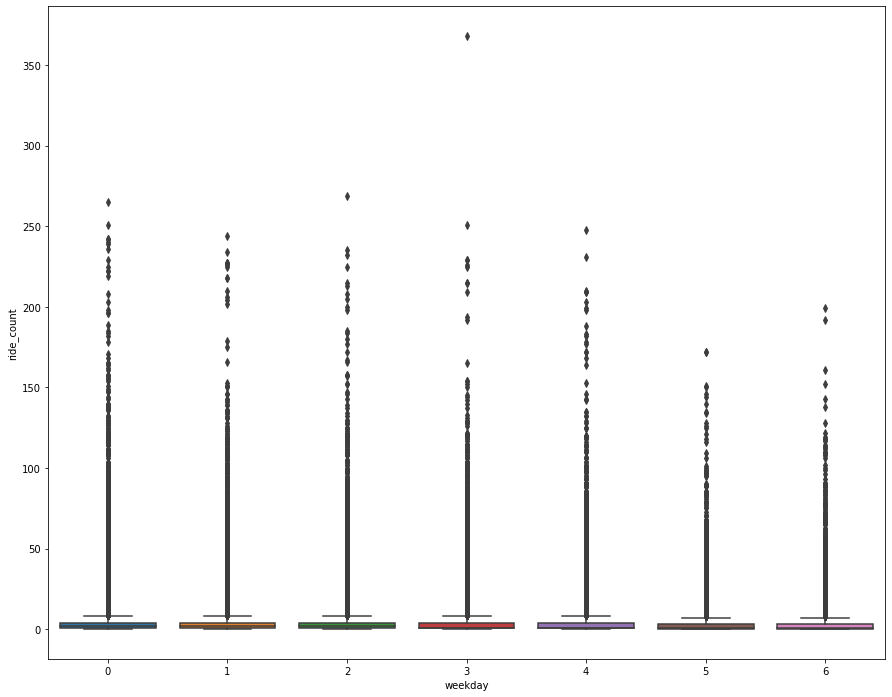

In [ ]:
plt.figure(figsize=(15, 12))
sns.boxplot(data=train_re, x="weekday", y="ride_count")
plt.show()

#### 4) folium--아직안함

In [ ]:
m=folium.Map(location=[33.383293, 126.259003], zoom_start=13)

for idx, rows in bus_code.iterrows():
        folium.Circle(location=[lat,lng],
                      radius=rows.설치연도*0.1, 
                      fill=True, 
                      color="blue"
                      fill_color="white"
                     ).add_to(m)    
m

## 5. 모델링

### (1) !pip install

In [1]:
# 설치해야 할 것들
!pip install h5py
!pip install typing-extensions
!pip install wheel
!pip install catboost
!pip install pycaret[full] markupsafe==2.0.1 pyyaml==5.4.1 -qq

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 76.6 MB 100 kB/s 
     |████████████████████████████████| 320 kB 8.0 MB/s 
     |████████████████████████████████| 636 kB 84.1 MB/s 
     |████████████████████████████████| 1.3 MB 60.4 MB/s 
     |████████████████████████████████| 56 kB 5.9 MB/s 
     |████████████████████████████████| 3.3 MB 61.3 MB/s 
     |████████████████████████████████| 262 kB 82.2 MB/s 
     |████████████████████████████████| 10.4 MB 7.7 MB/s 
     |████████████████████████████████| 17.9 MB 61.2 MB/s 
     |████████████████████████████████| 25.9 MB 1.2 MB/s 
     |████████████████████

In [5]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


In [6]:
import jinja2
from pycaret.regression import *

### (2) 데이터 불러오기

In [7]:
# 원본 데이터
train = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/train.csv')
test = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/test.csv')
bts = pd.read_csv('/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data/bus_bts.csv')

In [8]:
# 수정한 데이터
bts_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bts_amend.csv", index_col = 0)
bus_code=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/bus_code_amend.csv", index_col = 0)
test_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/test_amend.csv", index_col = 0)
train_re=pd.read_csv("/content/drive/MyDrive/Project/팀 프로젝트/2_jeju_bus/data_re/train_amend.csv", index_col = 0)
train_re.head(10)

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,8~9_ride,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,typhoon,rain,holiday,weekday,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,2.0,5.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",16.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,4.0,2.0,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",22.0,0.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",4.0,0.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,6.0,26.0,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",79.0,0.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646",0.0,1.0
5,5,2019-09-01,4270000,시내,1648,예래입구,33.25862,126.40442,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,0,0,1,"33.25862,126.40442","4270000,1648",1.0,2.0
6,6,2019-09-01,4270000,시외,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,3.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,0,0,1,"33.24309,126.42472","4270000,1660",3.0,6.0
7,7,2019-09-01,4270000,시외,1666,창천리,33.26598,126.37082,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,0,0,1,"33.26598,126.37082","4270000,1666",1.0,1.0
8,8,2019-09-01,4270000,시외,1726,강정농협,33.23603,126.47827,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,0,0,1,"33.23603,126.47827","4270000,1726",1.0,1.0
9,9,2019-09-01,4270000,시내,2008,서귀포항,33.23977,126.56450,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,0,0,1,"33.23977,126.5645","4270000,2008",0.0,4.0


In [9]:
train_re.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 415423 entries, 0 to 415422
Data columns (total 42 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             415423 non-null  int64  
 1   date           415423 non-null  object 
 2   bus_route_id   415423 non-null  int64  
 3   in_out         415423 non-null  object 
 4   station_code   415423 non-null  int64  
 5   station_name   415423 non-null  object 
 6   latitude       415423 non-null  float64
 7   longitude      415423 non-null  float64
 8   6~7_ride       415423 non-null  float64
 9   7~8_ride       415423 non-null  float64
 10  8~9_ride       415423 non-null  float64
 11  9~10_ride      415423 non-null  float64
 12  10~11_ride     415423 non-null  float64
 13  11~12_ride     415423 non-null  float64
 14  6~7_takeoff    415423 non-null  float64
 15  7~8_takeoff    415423 non-null  float64
 16  8~9_takeoff    415423 non-null  float64
 17  9~10_takeoff   415423 non-nul

In [10]:
test_re.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 228170 entries, 0 to 228169
Data columns (total 41 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             228170 non-null  int64  
 1   date           228170 non-null  object 
 2   bus_route_id   228170 non-null  int64  
 3   in_out         228170 non-null  object 
 4   station_code   228170 non-null  int64  
 5   station_name   228170 non-null  object 
 6   latitude       228170 non-null  float64
 7   longitude      228170 non-null  float64
 8   6~7_ride       228170 non-null  float64
 9   7~8_ride       228170 non-null  float64
 10  8~9_ride       228170 non-null  float64
 11  9~10_ride      228170 non-null  float64
 12  10~11_ride     228170 non-null  float64
 13  11~12_ride     228170 non-null  float64
 14  6~7_takeoff    228170 non-null  float64
 15  7~8_takeoff    228170 non-null  float64
 16  8~9_takeoff    228170 non-null  float64
 17  9~10_takeoff   228170 non-nul

### (3) 데이터 정리

In [11]:
# 테이블에서 필요없는 컬럼들 제거하기(본 자료는 다 예시입니다.)
train_x = train_re.drop(['id', 'date', 'in_out', 'station_name'], axis = 1)
test_x = test_re.drop(['id', 'date', 'in_out', 'station_name'], axis = 1)
train_x.head()

,bus_route_id,station_code,latitude,longitude,6~7_ride,7~8_ride,8~9_ride,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,typhoon,rain,holiday,weekday,weekday0,weekday1,weekday2,weekday3,weekday4,weekday5,weekday6,inout_class,in,out,si_class,si_jeju,si_seogwipo,lat_lng,route_code,ride_count,takeoff_count
0,4270000,344,33.48990,126.49373,0.0,1.0,2.0,5.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.4899,126.49373","4270000,344",16.0,0.0
1,4270000,357,33.48944,126.48508,1.0,4.0,4.0,2.0,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.48944,126.48508","4270000,357",22.0,0.0
2,4270000,432,33.48181,126.47352,1.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0,0,6,0,0,0,0,0,0,1,0,0,1,1,1,0,"33.48181,126.47352","4270000,432",4.0,0.0
3,4270000,1579,33.50577,126.49252,0.0,17.0,6.0,26.0,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,1,1,0,"33.50577,126.49252","4270000,1579",79.0,0.0
4,4270000,1646,33.25579,126.41260,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0,0,6,0,0,0,0,0,0,1,1,1,0,0,0,1,"33.255790000000005,126.4126","4270000,1646",0.0,1.0


In [12]:
train_x.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 415423 entries, 0 to 415422
Data columns (total 38 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   bus_route_id   415423 non-null  int64  
 1   station_code   415423 non-null  int64  
 2   latitude       415423 non-null  float64
 3   longitude      415423 non-null  float64
 4   6~7_ride       415423 non-null  float64
 5   7~8_ride       415423 non-null  float64
 6   8~9_ride       415423 non-null  float64
 7   9~10_ride      415423 non-null  float64
 8   10~11_ride     415423 non-null  float64
 9   11~12_ride     415423 non-null  float64
 10  6~7_takeoff    415423 non-null  float64
 11  7~8_takeoff    415423 non-null  float64
 12  8~9_takeoff    415423 non-null  float64
 13  9~10_takeoff   415423 non-null  float64
 14  10~11_takeoff  415423 non-null  float64
 15  11~12_takeoff  415423 non-null  float64
 16  18~20_ride     415423 non-null  float64
 17  typhoon        415423 non-nul

In [13]:
# reproducibility 씨드의 배열은 랜덤하지 않게 유지하기 위한 장치
def seed_all(seed_num):
    rn.seed(seed_num)
    os.environ['PYTHONHASHSEED'] = str(seed_num)
    np.random.seed(seed_num)

seed_all(45)

In [ ]:
seed_num = 45
py_reg = setup(train_x, target = '18~20_ride', fold_shuffle = True, session_id = seed_num, normalize = True, silent = True, remove_outliers = True)
# 괄호 설명 : (사용할 데이터, 예측하고자 하는 컬럼, 샘플데이터를 섞음, 아까 정한 랜덤값을 설정으로 둠, 정규화, 나중에 밑에 많이 뜨는거 조용히ㅎ, 이상치 제거)

IntProgress(value=0, description='Processing: ', max=3)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,16:22:08
Status,. . . . . . . . . . . . . . . . . .,Preprocessing Data


tcmalloc: large alloc 36828733440 bytes == 0x9fef0000 @  0x7ff3ef36e001 0x7ff3e150354f 0x7ff3e1553b58 0x7ff3e1557b17 0x7ff3e15f6203 0x593835 0x548c51 0x5127f1 0x593dd7 0x548ae9 0x51566f 0x549576 0x593fce 0x548ae9 0x51566f 0x549576 0x593fce 0x511e2c 0x549576 0x4bcb19 0x59c019 0x595ef6 0x5134a6 0x549576 0x4bca8a 0x5134a6 0x549576 0x4bca8a 0x532e76 0x595ef6 0x5134a6


In [ ]:
best_models = compare_models(n_select=37, sort='RMSE')
# n_select는 사용할 파라미터의 갯수

In [ ]:
# 상위 3개 모델 생성
catboost = create_model('catboost', verbose = False)
rf = create_model('rf', verbose = False)
lightgbm = create_model('lightgbm', verbose = False)
# verbose information grid 를 표시할지 말지? verbose False로 하면 표시 안함. 확인을 위해 해봐도 좋음

In [ ]:
# 세개의 모델을 블랜딩 해볼 수 있음(이 모델은 어디까지나 예시임)
blend_models = blend_models(estimator_list = [catboost, rf, lightgbm])

In [ ]:
# 마지막 학습, test 예측
final_model = finalize_model(blend_models)
prediction = predict_model(final_model, data = test_x)